<a href="https://colab.research.google.com/github/mrudulamadhavan/MrudulaAP_Scifor/blob/main/MiniProject%202/NinjaCart_Image_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Image Classification using Computer Vision**


#### **About Ninjacart**

Ninjacart is India's largest fresh produce supply chain company. They are pioneers in solving one of the toughest supply chain problems of the world by leveraging innovative technology. They source fresh produce from farmers and deliver them to businesses within 12 hours.

#### **Problem Statement**

An integral component of the automation process is the development of robust classifiers which can distinguish between images of different types of vegetables, while also correctly labeling images that do not contain any one type of vegetable as noise.


Ninjacart has provided us with a dataset containing images scraped from the web.The dataset provided has images of the following food items:

 * noise - Indian market
 * images of vegetables - onion, potato and tomato.

This dataset contains train and test folders, each having 4 sub-folders with images of onions, potatoes, tomatoes and some market scenes.

The folder **train**  has a total of 3135 images, split into four folders as follows:

> * Tomato : 789
> * Potato : 898
> * Onion : 849
> * Indian market : 599

The folder **test**  has a total of 351 images, split into four folders

> * Tomato : 106
> * Potato : 83
> * Onion : 81
> * Indian market : 81

### **Objective**

To develop a program that can recognize the vegetable item(s) in a photo and identify them for the user.

### **Concepts Tested:**

> * Dataset Preparation & Visualization
> * CNN models
> * Implementing Callbacks
> * Deal with Overfitting
> * Transfer Learning

In [ ]:
# importing libraries
import os
import glob
import random
import pandas as pd
import seaborn as sns
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import cv2

import warnings
warnings.filterwarnings('ignore')

In [ ]:
import gdown
url = 'https://drive.google.com/uc?id=1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT'
output = 'ninjacart_data.zip'
gdown.download(url, output, quiet=False)
!unzip -q ninjacart_data.zip

Downloading...
From (original): https://drive.google.com/uc?id=1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT
From (redirected): https://drive.google.com/uc?id=1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT&confirm=t&uuid=ee0e8750-8df4-426b-b58d-7e4f522ed532
To: /content/ninjacart_data.zip
100%|██████████| 275M/275M [00:02<00:00, 134MB/s]


In [ ]:
root_dir = "/content/ninjacart_data/"
train_dir = f"{root_dir}train/"
test_dir = f"{root_dir}test/"

# **Dataset Overview & Exploratory Data Analysis**

In [ ]:
import pathlib
def count_files(rootdir):
    '''counts the number of files in each subfolder in a directory'''
    for path in pathlib.Path(rootdir).iterdir():
        if path.is_dir():
            print("     >  " + str(len([name for name in os.listdir(path) \
            if os.path.isfile(os.path.join(path, name))])) + " files in " + \
            str(path.name))
    print()


print("In Train data,there are :")
count_files(os.path.join(train_dir))
class_names = sorted(os.listdir(train_dir))
n_classes = len(class_names)
print(f"    Total number of classes: {n_classes}")
print(f"    Name of classes: {class_names}")

print("-"*50)
print("In Test data,there are :")
count_files(os.path.join(test_dir))
class_names = sorted(os.listdir(test_dir))
n_classes = len(class_names)
print(f"    Total number of classes: {n_classes}")
print(f"    Name of classes: {class_names}")


In Train data,there are :
     >  849 files in onion
     >  599 files in indian market
     >  789 files in tomato
     >  898 files in potato

    Total number of classes: 4
    Name of classes: ['indian market', 'onion', 'potato', 'tomato']
--------------------------------------------------
In Test data,there are :
     >  83 files in onion
     >  81 files in indian market
     >  106 files in tomato
     >  81 files in potato

    Total number of classes: 4
    Name of classes: ['indian market', 'onion', 'potato', 'tomato']


### **Visualization of Train data**

* To visualize the data, use the dataset directory to create a list containing all the image paths in the training folder.
* Plot a grid sample of the images fetched from the list of image paths.

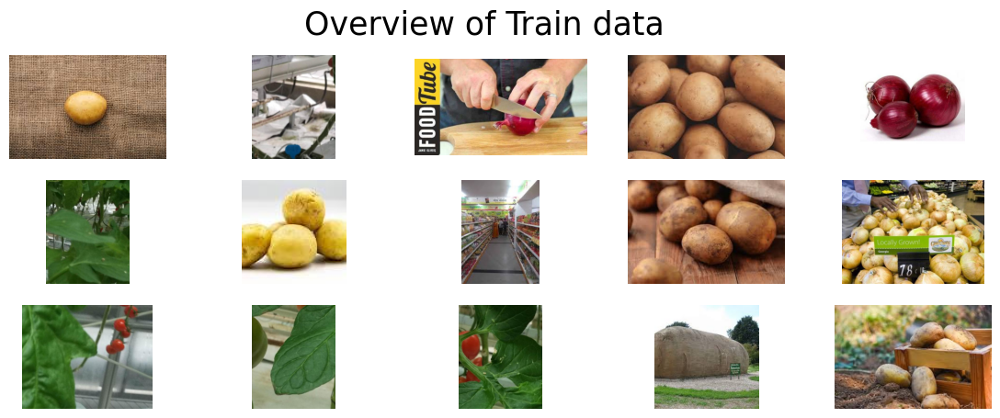

In [ ]:
# Collect image paths
images = []
for folder in os.listdir(train_dir):
    for image in os.listdir(os.path.join(train_dir, folder)):
        images.append(os.path.join(train_dir, folder, image))

# Plot a random selection of images
fig, axes = plt.subplots(3,5, figsize=(14, 5))
fig.suptitle('Overview of Train data', fontsize=25)
plt.axis('off')

for ax in axes.flatten():
    # Randomly select an image
    random_img = random.choice(images)

    # Load and display the image
    img = tf.keras.utils.load_img(random_img)  # Adjust target_size as needed
    ax.imshow(img)
    ax.axis('off')

plt.show()

In [ ]:
class_dirs = os.listdir(train_dir)
image_dict = {}
count_dict = {}

# iterate over all class_dirs
for cls in class_dirs:
    # get list of all paths inside the subdirectory
    file_paths = glob.glob(os.path.join(train_dir, cls, '*'))

    # count number of files in each class and add it to count_dict
    count_dict[cls] = len(file_paths)

    # select a random item from the list of image paths
    random_image_path = random.choice(file_paths)

    # load image using keras utility function and save it in image_dict
    img = tf.keras.utils.load_img(random_image_path)  # Adjust target_size as needed
    image_dict[cls] = img


In [ ]:
##  Data Distribution of Training Data across Classes
df_count_train = pd.DataFrame({
    "class": count_dict.keys(),     # keys of count_dict are class labels
    "count": count_dict.values(),   # value of count_dict contain counts of each class
})
print("Count of training samples per class:\n\n", df_count_train)

Count of training samples per class:

            class  count
0          onion    849
1  indian market    599
2         tomato    789
3         potato    898


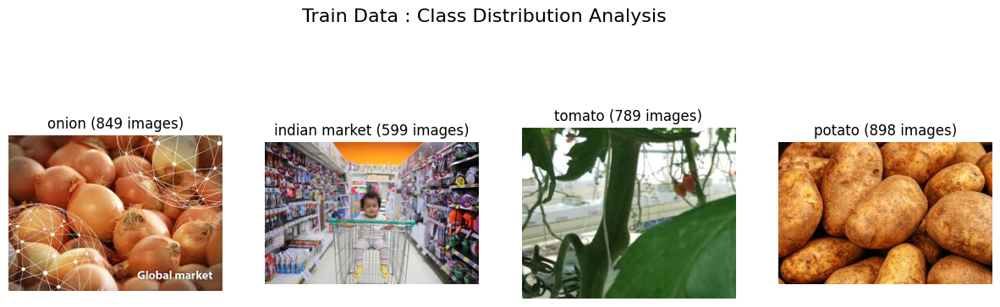

In [ ]:
# Plot the random images
fig, axes = plt.subplots(1, len(class_dirs), figsize=(15, 5))
fig.suptitle('Train Data : Class Distribution Analysis', fontsize=16)

for i, cls in enumerate(class_dirs):
    axes[i].imshow(image_dict[cls])
    axes[i].set_title(f'{cls} ({count_dict[cls]} images)')
    axes[i].axis('off')

plt.show()

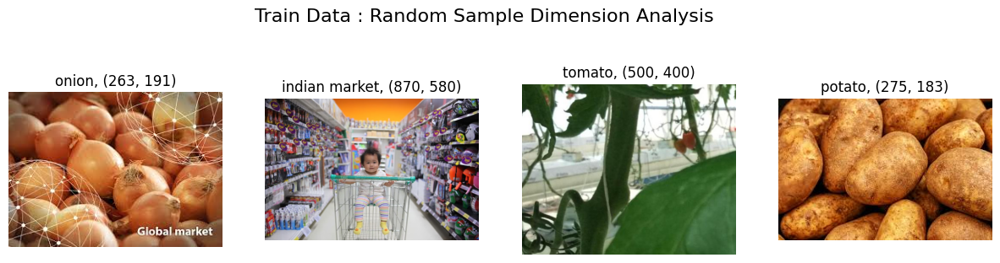

In [ ]:
# Plot the random images with dimension

fig, axes = plt.subplots(1, len(class_dirs), figsize=(15, 9))
fig.suptitle('Train Data : Random Sample Dimension Analysis', fontsize=16)

# iterate over dictionary items (class label, image array)
for i, (cls,img) in enumerate(image_dict.items()):
    # create a subplot axis
    ax = plt.subplot(3,4, i + 1)
    # plot each image
    plt.imshow(img)
    # set "class name" along with "image size" as title
    plt.title(f'{cls}, {img.size}')
    plt.axis("off")

### **Distribution of classes in Train data**

In [ ]:
import plotly.express as px
# Calculate class distribution
class_dis = [len(os.listdir(train_dir +'/'+ name)) for name in class_names]

# Visualize using interactive pie chart
pie_chart = px.pie(values=class_dis, names=class_names, color=class_names)
pie_chart.update_layout({'title':{'text':"Class Distribution Analysis in Train data"}},title_x=0.5)
pie_chart.update_traces(textposition='inside', textinfo='label + percent')

pie_chart.show()

# Visualize using interactive bar chart
bar_chart = px.bar(y=class_dis, x=class_names, color=class_names,text = class_dis ,labels={'x': 'Class', 'y':'Sample Count'})
bar_chart.update_layout({'title':{'text':"Class Distribution Analysis in Train data"}},title_x=0.5)
bar_chart.show()

### **Visualization of Test data**

* To visualize the data, use the dataset directory to create a list containing all the image paths in the testing folder.
* Plot a grid sample of the images fetched from the list of image paths.

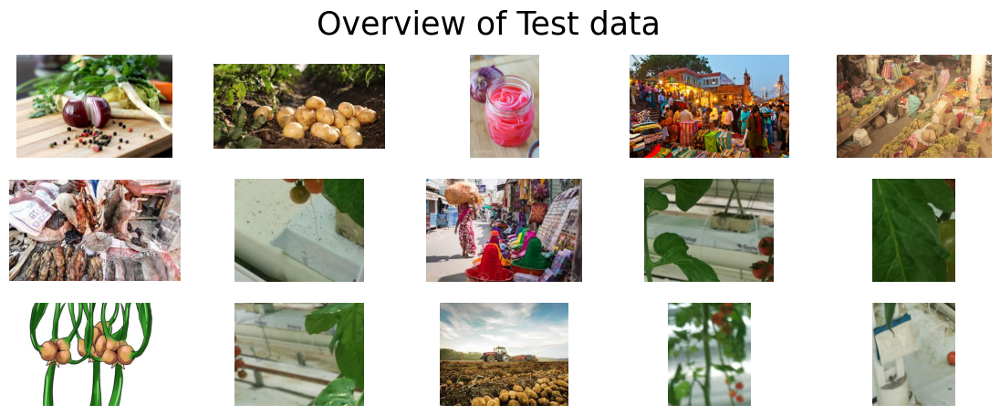

In [ ]:
# Collect image paths
images = []
for folder in os.listdir(test_dir):
    for image in os.listdir(os.path.join(test_dir, folder)):
        images.append(os.path.join(test_dir, folder, image))

# Plot a random selection of images
fig, axes = plt.subplots(3,5, figsize=(14, 5))
fig.suptitle('Overview of Test data', fontsize=25)
plt.axis('off')

for ax in axes.flatten():
    # Randomly select an image
    random_img = random.choice(images)

    # Load and display the image
    img = tf.keras.utils.load_img(random_img)  # Adjust target_size as needed
    ax.imshow(img)
    ax.axis('off')

plt.show()

In [ ]:
class_dirs = os.listdir(test_dir)
image_dict = {}
count_dict = {}

# iterate over all class_dirs
for cls in class_dirs:
    # get list of all paths inside the subdirectory
    file_paths = glob.glob(os.path.join(test_dir, cls, '*'))

    # count number of files in each class and add it to count_dict
    count_dict[cls] = len(file_paths)

    # select a random item from the list of image paths
    random_image_path = random.choice(file_paths)

    # load image using keras utility function and save it in image_dict
    img = tf.keras.utils.load_img(random_image_path)  # Adjust target_size as needed
    image_dict[cls] = img

##  Data Distribution of Testing Data across Classes
df_count_test = pd.DataFrame({
    "class": count_dict.keys(),     # keys of count_dict are class labels
    "count": count_dict.values(),   # value of count_dict contain counts of each class
})
print("Count of testing samples per class:\n\n", df_count_test)


Count of testing samples per class:

            class  count
0          onion     83
1  indian market     81
2         tomato    106
3         potato     81


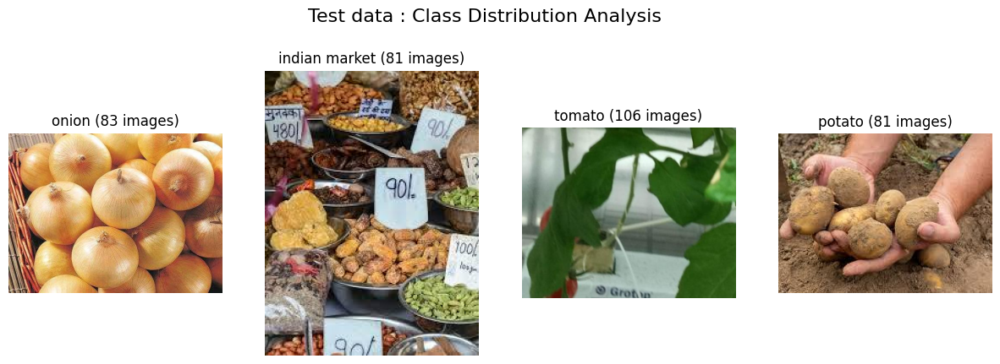

In [ ]:
# Plot the class distribution
fig, axes = plt.subplots(1, len(class_dirs), figsize=(15, 5))
fig.suptitle('Test data : Class Distribution Analysis', fontsize=16)

for i, cls in enumerate(class_dirs):
    axes[i].imshow(image_dict[cls])
    axes[i].set_title(f'{cls} ({count_dict[cls]} images)')
    axes[i].axis('off')

plt.show()

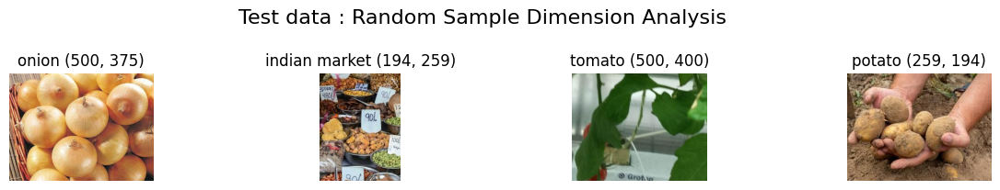

In [ ]:
## Random Sample from each class with their dimension

# Plot the random images
fig, axes = plt.subplots(1, len(class_dirs), figsize=(15, 7))
fig.suptitle('Test data : Random Sample Dimension Analysis', fontsize=16)

# iterate over dictionary items (class label, image array)
for i, (cls,img) in enumerate(image_dict.items()):
    # create a subplot axis
    ax = plt.subplot(4, 4, i + 1)
    # plot each image
    plt.imshow(img)
    # set "class name" along with "image size" as title
    plt.title(f'{cls} {img.size}')
    plt.axis("off")

### **Distribution of classes in Test data**

In [ ]:
import plotly.express as px
# Calculate class distribution
class_dis = [len(os.listdir(test_dir+ '/' + name)) for name in class_names]

# Visualize using interactive pie chart
pie_chart = px.pie(values=class_dis, names=class_names, color=class_names)
pie_chart.update_layout({'title':{'text':"Class Distribution Analysis in Test data"}},title_x=0.5)
pie_chart.update_traces(textposition='inside', textinfo='label + percent')

pie_chart.show()

# Visualize using interactive bar chart
bar_chart = px.bar(y=class_dis, x=class_names, color=class_names,text = class_dis,labels={'x': 'Class', 'y':'Sample Count'})

bar_chart.update_layout({'title':{'text':"Class Distribution Analysis in Test data"}},title_x=0.5)

bar_chart.show()

## **Data Preparation**

#### **Split the dataset to a train and validation set.**

In [ ]:
root_dir = "/content/ninjacart_data/"
train_dir = f"{root_dir}train/"
test_dir = f"{root_dir}test/"

image_size = (256, 256)

In [ ]:
train_ds = tf.keras.utils.image_dataset_from_directory(directory = train_dir,
                                                       label_mode = 'categorical',
                                                       batch_size = 32,
                                                       image_size = image_size,
                                                       seed = 2022,
                                                       validation_split = 0.2,
                                                       subset = "training",
                                                       shuffle=True)

Found 3135 files belonging to 4 classes.
Using 2508 files for training.


In [ ]:
valid_ds = tf.keras.utils.image_dataset_from_directory(directory = train_dir,
                                                       label_mode = 'categorical',
                                                       batch_size = 32,
                                                       image_size = image_size,
                                                       seed = 2022,
                                                       validation_split = 0.2,
                                                       subset = "validation")

Found 3135 files belonging to 4 classes.
Using 627 files for validation.


In [ ]:
test_ds = tf.keras.utils.image_dataset_from_directory(directory = test_dir,
                                                       label_mode = 'categorical',
                                                       batch_size = 32,
                                                       image_size = image_size,
                                                       seed = 2022,
                                                      )

Found 351 files belonging to 4 classes.


Here `label_mode = 'categorical'` , hence one-hot encodes the classes alphabetically, i.e,
* *indian market* (noise)  = class 0
* *onion* = class 1
* *potato* = class 2
* *tomato* = class 3

In [ ]:
class_names = ['noise', 'onion', 'potato', 'tomato']
class_map = {0:'noise',1:'onion',2:'potato',3:'tomato'}

# **Creating model architecture and training of models**

#### **1) Base CNN Classifier Model**



In [ ]:
model = tf.keras.Sequential([


tf.keras.layers.Rescaling(1./255),
tf.keras.layers.InputLayer(input_shape = [image_size[0], image_size[1], 3]),

tf.keras.layers.Conv2D(filters = 32, kernel_size = (3,3), padding = 'Same', activation = 'relu'),
tf.keras.layers.Conv2D(filters = 32, kernel_size = (3,3), padding = 'Same', activation = 'relu'),
tf.keras.layers.MaxPool2D(pool_size = (2,2)),

tf.keras.layers.Conv2D(filters = 64, kernel_size = (3,3), padding = 'Same', activation = 'relu'),
tf.keras.layers.Conv2D(filters = 64, kernel_size = (3,3), padding = 'Same', activation = 'relu'),
tf.keras.layers.MaxPool2D(pool_size = (2,2)),

tf.keras.layers.Conv2D(filters = 128, kernel_size = (3,3), padding = 'Same', activation = 'relu'),

tf.keras.layers.GlobalAveragePooling2D(),
tf.keras.layers.Dense(4, activation = 'softmax')
])

In [ ]:
model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4),
              loss = tf.keras.losses.CategoricalCrossentropy(),
              metrics = ['accuracy', 'Precision', 'Recall'])

In [ ]:
log_dir_base = "logs/base_model"
tensorboard_cb = tf.keras.callbacks.TensorBoard(log_dir=log_dir_base, histogram_freq=1)
%load_ext tensorboard
log_folder = log_dir_base
history = model.fit(train_ds, epochs=20, validation_data=valid_ds, callbacks=[tensorboard_cb])

Epoch 1/20
79/79 [==============================] - 29s 221ms/step - loss: 1.3446 - accuracy: 0.3082 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 1.2777 - val_accuracy: 0.4657 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/20
79/79 [==============================] - 13s 161ms/step - loss: 1.0511 - accuracy: 0.6136 - precision: 0.8379 - recall: 0.1938 - val_loss: 0.8394 - val_accuracy: 0.7002 - val_precision: 0.8352 - val_recall: 0.4689
Epoch 3/20
79/79 [==============================] - 14s 166ms/step - loss: 0.7606 - accuracy: 0.7117 - precision: 0.7970 - recall: 0.5809 - val_loss: 0.7139 - val_accuracy: 0.7193 - val_precision: 0.7769 - val_recall: 0.6332
Epoch 4/20
79/79 [==============================] - 15s 176ms/step - loss: 0.6993 - accuracy: 0.7333 - precision: 0.8060 - recall: 0.6495 - val_loss: 0.7268 - val_accuracy: 0.7241 - val_precision: 0.7760 - val_recall: 0.6300
Epoch 5/20
79/79 [==============================] - 14s 163ms/step - loss: 0.6647 - 

In [ ]:
%tensorboard --logdir={log_folder} --port=6007

<IPython.core.display.Javascript object>

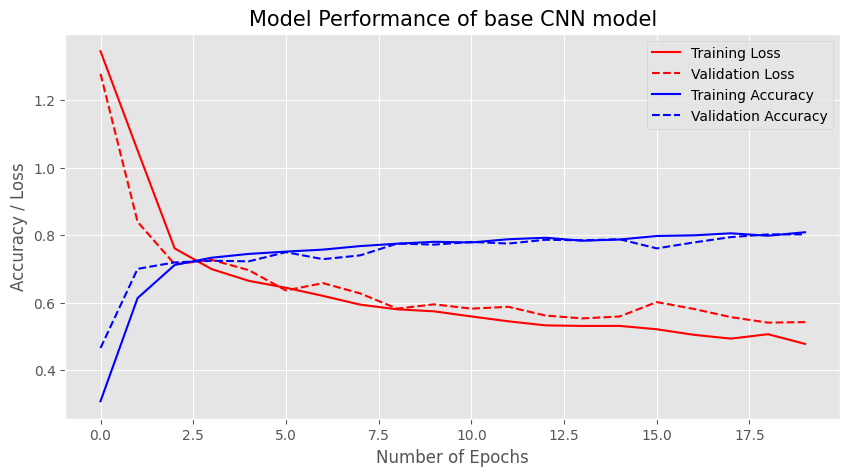

In [ ]:
# Plot the loss graph and accuracy graph
h = history.history
plt.style.use('ggplot')
plt.figure(figsize=(10, 5))
plt.plot(h['loss'], c='red', label='Training Loss')
plt.plot(h['val_loss'], c='red', linestyle='--', label='Validation Loss')
plt.plot(h['accuracy'], c='blue', label='Training Accuracy')
plt.plot(h['val_accuracy'], c='blue', linestyle='--', label='Validation Accuracy')
plt.xlabel("Number of Epochs")
plt.title('Model Performance of base CNN model', fontsize=15)
plt.ylabel("Accuracy / Loss")
plt.legend(loc='best')
plt.show()

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 256, 256, 3)       0         
                                                                 
 input_1 (InputLayer)        multiple                  0         
                                                                 
 conv2d (Conv2D)             (None, 256, 256, 32)      896       
                                                                 
 conv2d_1 (Conv2D)           (None, 256, 256, 32)      9248      
                                                                 
 max_pooling2d (MaxPooling2  (None, 128, 128, 32)      0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 64)      18496     
                                                        

In [ ]:
# Predict the accuracy for the test set
result = model.evaluate(test_ds)
dict(zip(model.metrics_names, result))

11/11 [==============================] - 4s 272ms/step - loss: 0.5546 - accuracy: 0.7350 - precision: 0.7910 - recall: 0.7009


{'loss': 0.5546144843101501,
 'accuracy': 0.7350427508354187,
 'precision': 0.790996789932251,
 'recall': 0.7008547186851501}

In [ ]:
l1,l2,l3,l4 = [],[],[],[]
sns.set(rc={'figure.figsize':(6, 6)})
sns.set(font_scale=1.2)

In [ ]:
noise_path = '/content/ninjacart_data/test/indian market'
onion_path = '/content/ninjacart_data/test/onion'
potato_path = '/content/ninjacart_data/test/potato'
tomato_path = '/content/ninjacart_data/test/tomato'

1/1 [==============================] - 0s 16ms/step


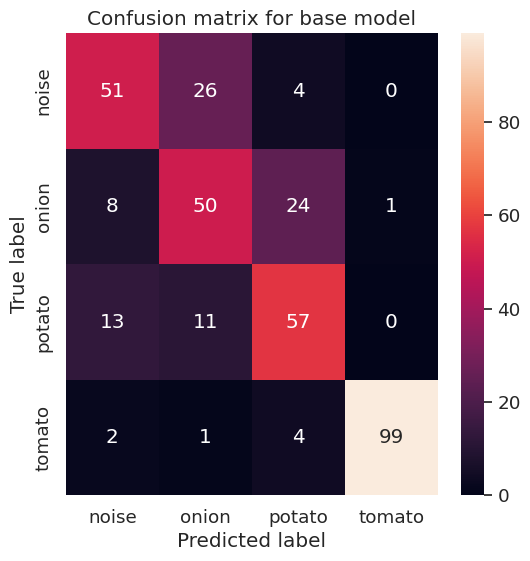

In [ ]:
def conf_mat(class_path, pred_list, model_name) :
    noise, tomato, potato, onion = 0, 0, 0, 0
    for i in os.listdir(class_path):

        img = tf.keras.utils.load_img(class_path + "/" + str(i))
        img = tf.keras.utils.img_to_array(img)
        img = tf.image.resize(img, (256, 256))
        img = tf.expand_dims(img, axis = 0)

        pred = model_name.predict(img)
        predicted = tf.argmax(pred, 1).numpy().item()

        if predicted == 0:
            noise+= 1
        elif predicted == 1:
            onion+= 1
        elif predicted == 2:
            potato+= 1
        else:
            tomato+= 1


    for item in noise, onion, potato, tomato :
        pred_list.append(item)

conf_mat(noise_path, l1, model)
conf_mat(onion_path, l2, model)
conf_mat(potato_path, l3, model)
conf_mat(tomato_path, l4, model)

ax = sns.heatmap([l1, l2, l3, l4], xticklabels=class_names, yticklabels=class_names, annot=True, fmt='g')
ax.set(xlabel='Predicted label', ylabel='True label',title = 'Confusion matrix for base model')
plt.show()

In [ ]:
test_images = []

for folder in os.listdir(test_dir):
  for image in os.listdir(test_dir + '/' + folder):
    test_images.append(os.path.join(test_dir, folder, image))

In [ ]:
def grid_test_model(model_name):

  fig = plt.figure(1, figsize=(17, 11))
  plt.axis('off')
  n = 0
  for i in range(8):
    n += 1

    img_0 = tf.keras.utils.load_img(random.choice(test_images))
    img_0 = tf.keras.utils.img_to_array(img_0)
    img_0 = tf.image.resize(img_0, (256, 256))
    img_1 = tf.expand_dims(img_0, axis = 0)

    pred = model_name.predict(img_1)
    predicted_label = tf.argmax(pred, 1).numpy().item()

    for item in pred :
      item = tf.round((item*100))

    plt.subplot(2, 4, n)
    plt.axis('off')
    plt.title(f'prediction : {class_names[predicted_label]}\n\n'
              f'{item[0]} % {class_names[0]}\n'
              f'{item[1]} % {class_names[1]}\n'
              f'{item[2]} % {class_names[2]}\n'
              f'{item[3]} % {class_names[3]}\n'
              )
    plt.imshow(img_0/255)
  plt.show()

1/1 [==============================] - 0s 24ms/step


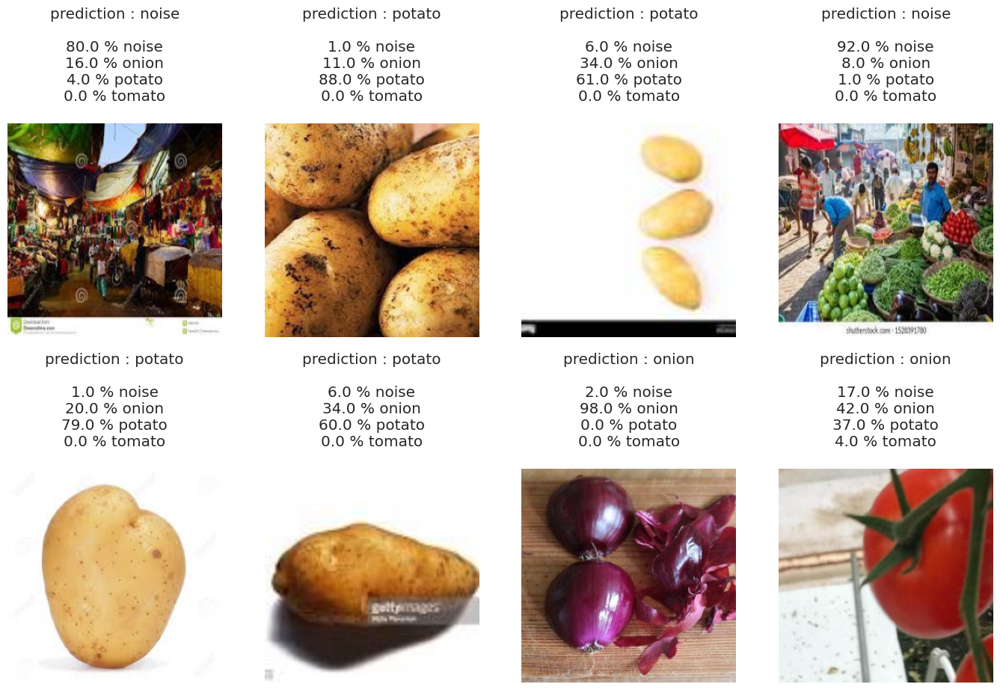

In [ ]:
grid_test_model(model)

In [ ]:
def classwise_accuracy(class_path, class_name, model_name) :
    paths = []
    for i in os.listdir(class_path):
        paths.append(class_path + "/" + str(i))

    correct = 0
    total = 0

    for i in range(len(paths)):
        total+= 1

        img = tf.keras.utils.load_img(paths[i])
        img = tf.keras.utils.img_to_array(img)
        img = tf.image.resize(img, (256, 256))
        img = tf.expand_dims(img, axis = 0)

        pred = model_name.predict(img)
        if tf.argmax(pred[0]) == class_names.index(f"{class_name}"):
            correct+= 1

    print(f"\n --> Accuracy for class {class_name} is {round((correct/total)*100, 2)}% consisting of {len(paths)} images \n")
    print('------------'*50)

In [ ]:
classwise_accuracy(noise_path, 'noise', model)
classwise_accuracy(onion_path, 'onion', model)
classwise_accuracy(potato_path, 'potato', model)
classwise_accuracy(tomato_path, 'tomato', model)

1/1 [==============================] - 0s 17ms/step

 --> Accuracy for class noise is 62.96% consisting of 81 images 

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1/1 [==============================] - 0s 30ms/step

 --> Accuracy for class onion is 60.24% consisting of 83 images 

-----------------------------------------------------------------------------------------------------------------------------------------------------------------

**Observations :**
* With base CNN model we get a test accuracy of 74% and train accuracy of 80%.
* Also, there are many misclassifications in predictions to actual labels in the dataset.

#### **2) Revamped CNN model**


The base model is overfitting as there is variation in training vs validation accuracy. Hence we try to tune our model by applying - :

* BatchNormalization and Dropout

* Callbacks : EarlyStopping, ModelCheckpoint and TensorBoard callback

* Data Augmentation

In [ ]:
augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal_and_vertical"),
    tf.keras.layers.RandomRotation(0.2),
    tf.keras.layers.RandomTranslation(height_factor = 0.2, width_factor=0.2)
])

aug_ds = train_ds

for image, label in aug_ds :
  image = augmentation(image)

In [ ]:
model_revamp = tf.keras.Sequential([

tf.keras.layers.Rescaling(1./255),
tf.keras.layers.InputLayer(input_shape = [image_size[0], image_size[1], 3]),

tf.keras.layers.Conv2D(filters = 32, kernel_size = (3,3), padding = 'Same', activation = 'relu'),
tf.keras.layers.Conv2D(filters = 32, kernel_size = (3,3), padding = 'Same', activation = 'relu'),
tf.keras.layers.BatchNormalization(),
tf.keras.layers.MaxPool2D(pool_size = (2,2)),

tf.keras.layers.Conv2D(filters = 64, kernel_size = (3,3), padding = 'Same', activation = 'relu'),
tf.keras.layers.Conv2D(filters = 64, kernel_size = (3,3), padding = 'Same', activation = 'relu'),
tf.keras.layers.BatchNormalization(),
tf.keras.layers.MaxPool2D(pool_size = (2,2)),

tf.keras.layers.Conv2D(filters = 128, kernel_size = (3,3), padding = 'Same', activation = 'relu'),
tf.keras.layers.BatchNormalization(),
tf.keras.layers.GlobalAveragePooling2D(),
tf.keras.layers.Dropout(rate = 0.2),

tf.keras.layers.Dense(4, activation = 'softmax')
])

In [ ]:
model_revamp.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4),
                    loss = tf.keras.losses.CategoricalCrossentropy(),
                    metrics = ['accuracy', 'Precision', 'Recall'])

In [ ]:
log_dir_revamp = "logs/basemodel_revamp"

tensorboard_cb = tf.keras.callbacks.TensorBoard(log_dir = log_dir_revamp, histogram_freq = 1)

checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("CNN_best.h5", save_best_only = True)

early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor = 'val_loss', patience = 5, restore_best_weights = True
)

In [ ]:
history_revamp= model_revamp.fit(
train_ds,
epochs=20,
validation_data = valid_ds,
callbacks=[tensorboard_cb, checkpoint_cb, early_stopping_cb])

Epoch 1/20
79/79 [==============================] - 20s 191ms/step - loss: 0.7121 - accuracy: 0.7344 - precision: 0.8180 - recall: 0.6112 - val_loss: 1.3924 - val_accuracy: 0.2887 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/20
79/79 [==============================] - 15s 186ms/step - loss: 0.5295 - accuracy: 0.7970 - precision: 0.8486 - recall: 0.7420 - val_loss: 1.4237 - val_accuracy: 0.4992 - val_precision: 1.0000 - val_recall: 0.0032
Epoch 3/20
79/79 [==============================] - 16s 196ms/step - loss: 0.4794 - accuracy: 0.8170 - precision: 0.8625 - recall: 0.7679 - val_loss: 1.3558 - val_accuracy: 0.4896 - val_precision: 0.8760 - val_recall: 0.3381
Epoch 4/20
79/79 [==============================] - 15s 183ms/step - loss: 0.4607 - accuracy: 0.8281 - precision: 0.8663 - recall: 0.7799 - val_loss: 1.2245 - val_accuracy: 0.4577 - val_precision: 0.7165 - val_recall: 0.3748
Epoch 5/20
79/79 [==============================] - 16s 193ms/step - loss: 0.4247 - accuracy

In [ ]:
model_revamp.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_1 (Rescaling)     (None, 256, 256, 3)       0         
                                                                 
 input_2 (InputLayer)        multiple                  0         
                                                                 
 conv2d_5 (Conv2D)           (None, 256, 256, 32)      896       
                                                                 
 conv2d_6 (Conv2D)           (None, 256, 256, 32)      9248      
                                                                 
 batch_normalization (Batch  (None, 256, 256, 32)      128       
 Normalization)                                                  
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 128, 128, 32)      0         
 g2D)                                                 

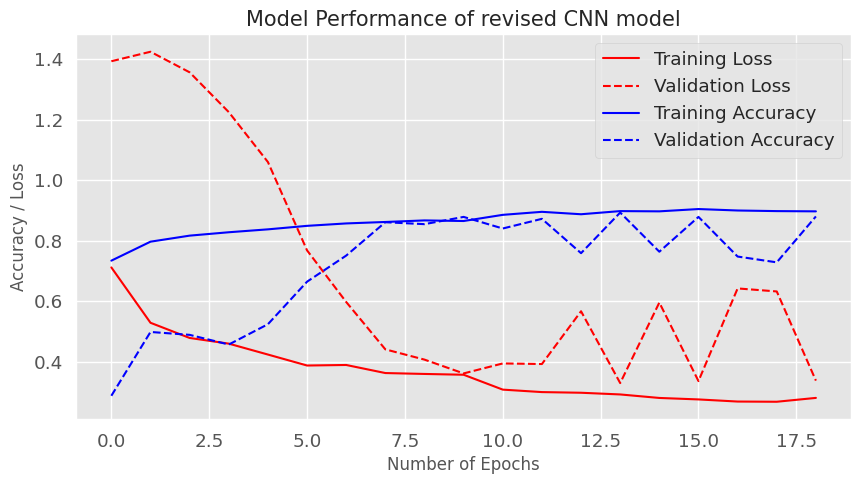

In [ ]:
# Plot the loss graph and accuracy graph
h = history_revamp.history
plt.style.use('ggplot')
plt.figure(figsize=(10, 5))
plt.plot(h['loss'], c='red', label='Training Loss')
plt.plot(h['val_loss'], c='red', linestyle='--', label='Validation Loss')
plt.plot(h['accuracy'], c='blue', label='Training Accuracy')
plt.plot(h['val_accuracy'], c='blue', linestyle='--', label='Validation Accuracy')
plt.xlabel("Number of Epochs")
plt.title('Model Performance of revised CNN model', fontsize=15)
plt.ylabel("Accuracy / Loss")
plt.legend(loc='best')
plt.show()

1/1 [==============================] - 0s 17ms/step


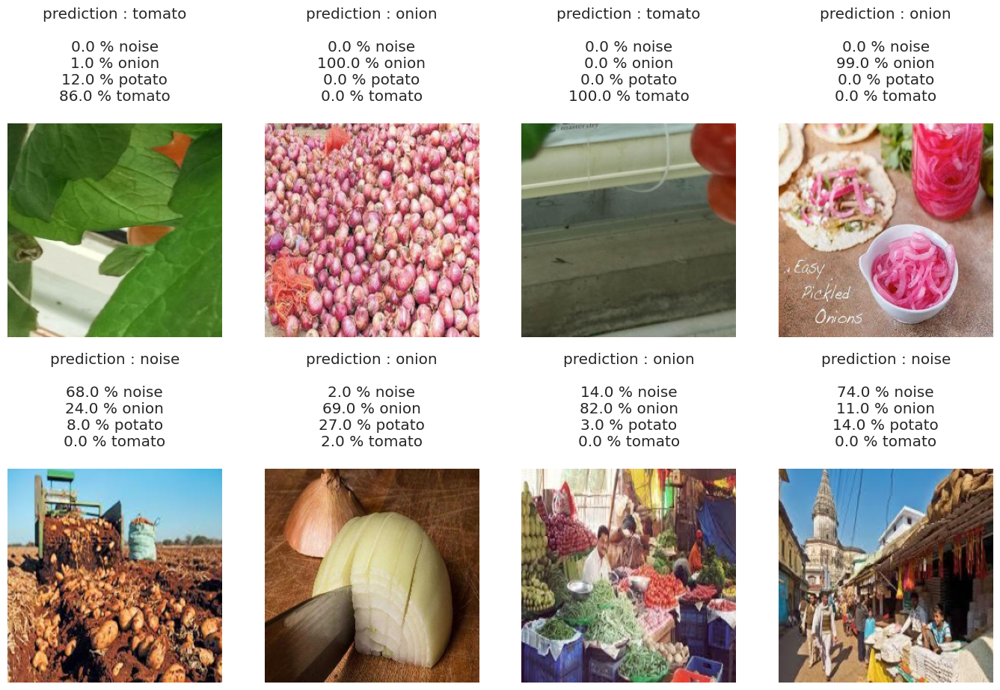

In [ ]:
grid_test_model(model_revamp)

In [ ]:
result = model_revamp.evaluate(test_ds)
dict(zip(model_revamp.metrics_names, result))

11/11 [==============================] - 2s 57ms/step - loss: 0.3215 - accuracy: 0.8803 - precision: 0.9050 - recall: 0.8689


{'loss': 0.3215109407901764,
 'accuracy': 0.8803418874740601,
 'precision': 0.9050444960594177,
 'recall': 0.8689458966255188}

1/1 [==============================] - 0s 18ms/step


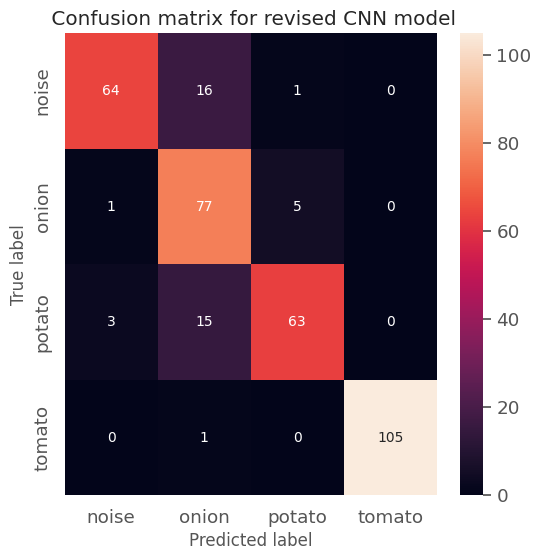

In [ ]:
l1 = []
l2 = []
l3 = []
l4 = []

conf_mat(noise_path, l1, model_revamp)
conf_mat(onion_path, l2, model_revamp)
conf_mat(potato_path, l3, model_revamp)
conf_mat(tomato_path, l4, model_revamp)

ax = sns.heatmap([l1, l2, l3, l4], xticklabels = class_names, yticklabels = class_names, annot = True, fmt = 'g')
ax.set(xlabel = 'Predicted label', ylabel = 'True label',title = ' Confusion matrix for revised CNN model')
plt.show()

In [ ]:
classwise_accuracy(noise_path, 'noise', model_revamp)
classwise_accuracy(onion_path, 'onion', model_revamp)
classwise_accuracy(potato_path, 'potato', model_revamp)
classwise_accuracy(tomato_path, 'tomato', model_revamp)

1/1 [==============================] - 0s 18ms/step

 --> Accuracy for class noise is 79.01% consisting of 81 images 

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1/1 [==============================] - 0s 19ms/step

 --> Accuracy for class onion is 92.77% consisting of 83 images 

-----------------------------------------------------------------------------------------------------------------------------------------------------------------

## > **Transfer Learning**
Next we will train 3 of the most efficient and accurate pretrained models on the ImageNet dataset using :
- VGG-19
- ResNet
- MobileNet

and compare the model performance to choose the best model from them.

### 3) **VGG19 Model**

In [ ]:
# VGG19
base_model_vgg = tf.keras.applications.vgg19.VGG19(input_shape=(256, 256, 3), include_top = False)
model_vgg = base_model_vgg.output
model_vgg = tf.keras.Sequential([
            tf.keras.layers.Rescaling(1./255),
            tf.keras.layers.InputLayer(input_shape=[image_size[0], image_size[1], 3]),
            base_model_vgg,
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dropout(rate = 0.1),
            tf.keras.layers.Dense(4, activation = 'softmax')
        ])

80134624/80134624 [==============================] - 4s 0us/step


In [ ]:
model_vgg.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4),
              loss = tf.keras.losses.CategoricalCrossentropy(),
              metrics = ['accuracy', 'Precision', 'Recall'])

In [ ]:
log_dir_vgg = "logs/model_vgg"

tensorboard_cb = tf.keras.callbacks.TensorBoard(log_dir=log_dir_vgg, histogram_freq=1)

checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("VGG19", save_best_only=True)

early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor = 'val_loss', patience = 5, restore_best_weights=True
)

In [ ]:
history_vgg = model_vgg.fit(aug_ds, validation_data = valid_ds, epochs = 20, callbacks=[tensorboard_cb, checkpoint_cb, early_stopping_cb])

Epoch 1/20
79/79 [==============================] - 109s 1s/step - loss: 0.7235 - accuracy: 0.6958 - precision: 0.7833 - recall: 0.5634 - val_loss: 0.5483 - val_accuracy: 0.7480 - val_precision: 0.7865 - val_recall: 0.7225
Epoch 2/20
79/79 [==============================] - 62s 783ms/step - loss: 0.3987 - accuracy: 0.8457 - precision: 0.8746 - recall: 0.8206 - val_loss: 0.3187 - val_accuracy: 0.9139 - val_precision: 0.9244 - val_recall: 0.8772
Epoch 3/20
79/79 [==============================] - 58s 731ms/step - loss: 0.3293 - accuracy: 0.8720 - precision: 0.8933 - recall: 0.8509 - val_loss: 0.3563 - val_accuracy: 0.8947 - val_precision: 0.9110 - val_recall: 0.8820
Epoch 4/20
79/79 [==============================] - 61s 765ms/step - loss: 0.2870 - accuracy: 0.8995 - precision: 0.9113 - recall: 0.8844 - val_loss: 0.3060 - val_accuracy: 0.9059 - val_precision: 0.9145 - val_recall: 0.9043
Epoch 5/20
79/79 [==============================] - 62s 780ms/step - loss: 0.1901 - accuracy: 0.9338 -

In [ ]:
model_vgg.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_2 (Rescaling)     (None, 256, 256, 3)       0         
                                                                 
 input_4 (InputLayer)        multiple                  0         
                                                                 
 vgg19 (Functional)          (None, 8, 8, 512)         20024384  
                                                                 
 global_average_pooling2d_2  (None, 512)               0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 4)                 2052      
                                                      

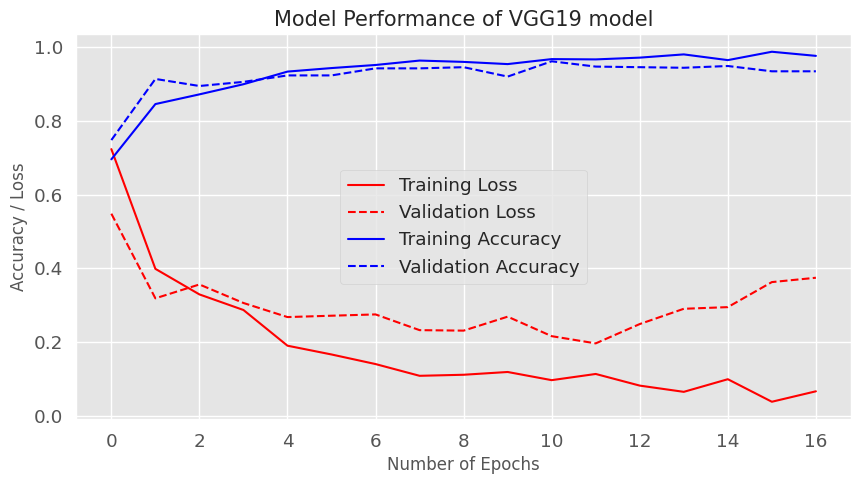

In [ ]:
# Plot the loss graph and accuracy graph
h = history_vgg.history
plt.style.use('ggplot')
plt.figure(figsize=(10, 5))
plt.plot(h['loss'], c='red', label='Training Loss')
plt.plot(h['val_loss'], c='red', linestyle='--', label='Validation Loss')
plt.plot(h['accuracy'], c='blue', label='Training Accuracy')
plt.plot(h['val_accuracy'], c='blue', linestyle='--', label='Validation Accuracy')
plt.xlabel("Number of Epochs")
plt.title('Model Performance of VGG19 model', fontsize=15)
plt.ylabel("Accuracy / Loss")
plt.legend(loc='best')
plt.show()

In [ ]:
classwise_accuracy(noise_path, 'noise', model_vgg)
classwise_accuracy(onion_path, 'onion', model_vgg)
classwise_accuracy(potato_path, 'potato', model_vgg)
classwise_accuracy(tomato_path, 'tomato', model_vgg)

1/1 [==============================] - 0s 23ms/step

 --> Accuracy for class noise is 79.01% consisting of 81 images 

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1/1 [==============================] - 0s 18ms/step

 --> Accuracy for class onion is 95.18% consisting of 83 images 

-----------------------------------------------------------------------------------------------------------------------------------------------------------------

1/1 [==============================] - 0s 19ms/step


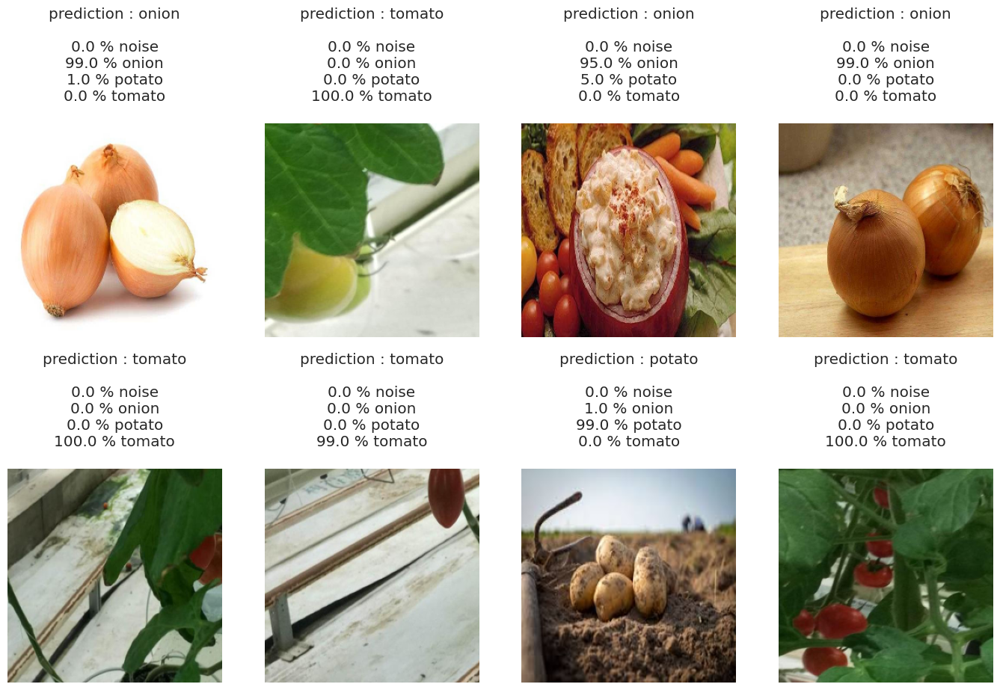

In [ ]:
grid_test_model(model_vgg)

In [ ]:
result = model_vgg.evaluate(test_ds)
dict(zip(model_vgg.metrics_names, result))

11/11 [==============================] - 10s 869ms/step - loss: 0.2798 - accuracy: 0.9202 - precision: 0.9226 - recall: 0.9174


{'loss': 0.27977824211120605,
 'accuracy': 0.9202279448509216,
 'precision': 0.922636091709137,
 'recall': 0.9173789024353027}

1/1 [==============================] - 0s 17ms/step


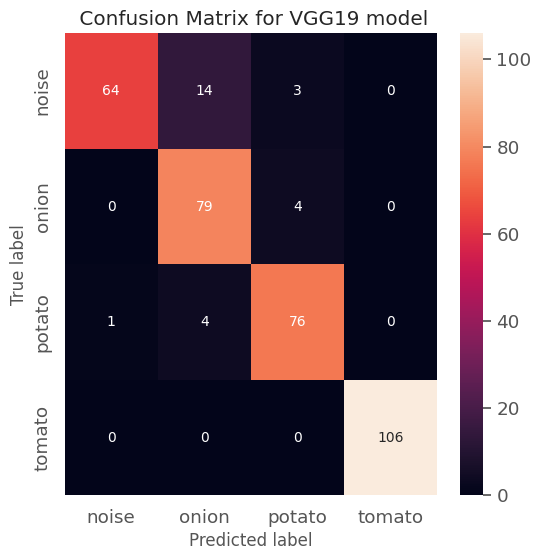

In [ ]:
l1 = []
l2 = []
l3 = []
l4 = []

conf_mat(noise_path, l1, model_vgg)
conf_mat(onion_path, l2, model_vgg)
conf_mat(potato_path, l3, model_vgg)
conf_mat(tomato_path, l4, model_vgg)

ax = sns.heatmap([l1, l2, l3, l4], xticklabels=class_names, yticklabels=class_names, annot=True, fmt='g')
ax.set(xlabel='Predicted label', ylabel='True label',title = ' Confusion Matrix for VGG19 model')
plt.show()

**Observations :**
* With VGG19 model we get a test accuracy of 90% and train accuracy of 99%.
* Also, the predictions are nearly 95% to actual labels in the dataset with some misclassifications.

### 4) **ResNet Model**

In [ ]:
# ResNet
base_model_res = tf.keras.applications.resnet50.ResNet50(input_shape=(256, 256, 3), include_top = False)
model_res = base_model_res.output

model_res = tf.keras.Sequential([

            tf.keras.layers.Rescaling(1./255),
            tf.keras.layers.InputLayer(input_shape=[image_size[0], image_size[1], 3]),
            base_model_res,
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dropout(rate = 0.1),
            tf.keras.layers.Dense(4, activation = 'softmax')
        ])

94765736/94765736 [==============================] - 5s 0us/step


In [ ]:
model_res.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4),
              loss = tf.keras.losses.CategoricalCrossentropy(),
              metrics = ['accuracy', 'Precision', 'Recall'])

In [ ]:
log_dir_res = "logs/model_resnet"

tensorboard_cb = tf.keras.callbacks.TensorBoard(log_dir=log_dir_res, histogram_freq=1)

checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("ResNet.h5", save_best_only=True)

early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor = 'val_loss', patience = 5, restore_best_weights=True
)

In [ ]:
history_res = model_res.fit(aug_ds, validation_data = valid_ds, epochs = 20, callbacks=[tensorboard_cb, checkpoint_cb, early_stopping_cb])

Epoch 1/20
79/79 [==============================] - 86s 614ms/step - loss: 0.1645 - accuracy: 0.9354 - precision: 0.9461 - recall: 0.9234 - val_loss: 4.0653 - val_accuracy: 0.2121 - val_precision: 0.2121 - val_recall: 0.2121
Epoch 2/20
79/79 [==============================] - 42s 527ms/step - loss: 0.0284 - accuracy: 0.9944 - precision: 0.9952 - recall: 0.9944 - val_loss: 2.9777 - val_accuracy: 0.2121 - val_precision: 0.2121 - val_recall: 0.2121
Epoch 3/20
79/79 [==============================] - 43s 531ms/step - loss: 0.0227 - accuracy: 0.9956 - precision: 0.9956 - recall: 0.9956 - val_loss: 1.8461 - val_accuracy: 0.2073 - val_precision: 0.2036 - val_recall: 0.1978
Epoch 4/20
79/79 [==============================] - 41s 509ms/step - loss: 0.0175 - accuracy: 0.9932 - precision: 0.9932 - recall: 0.9932 - val_loss: 2.0024 - val_accuracy: 0.3333 - val_precision: 0.3083 - val_recall: 0.2424
Epoch 5/20
79/79 [==============================] - 41s 506ms/step - loss: 0.0157 - accuracy: 0.9960

In [ ]:
model_res.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_3 (Rescaling)     (None, 256, 256, 3)       0         
                                                                 
 input_6 (InputLayer)        multiple                  0         
                                                                 
 resnet50 (Functional)       (None, 8, 8, 2048)        23587712  
                                                                 
 global_average_pooling2d_3  (None, 2048)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dropout_2 (Dropout)         (None, 2048)              0         
                                                                 
 dense_3 (Dense)             (None, 4)                 8196      
                                                      

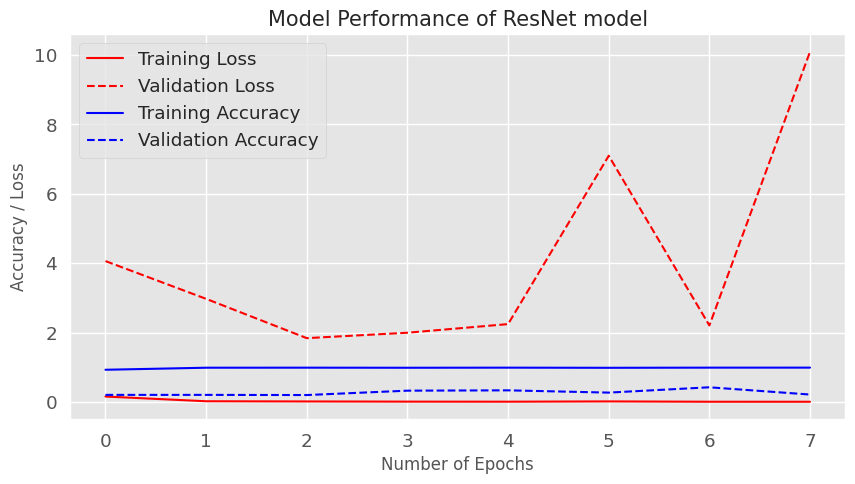

In [ ]:
# Plot the loss graph and accuracy graph
h = history_res.history
plt.style.use('ggplot')
plt.figure(figsize=(10, 5))
plt.plot(h['loss'], c='red', label='Training Loss')
plt.plot(h['val_loss'], c='red', linestyle='--', label='Validation Loss')
plt.plot(h['accuracy'], c='blue', label='Training Accuracy')
plt.plot(h['val_accuracy'], c='blue', linestyle='--', label='Validation Accuracy')
plt.xlabel("Number of Epochs")
plt.title('Model Performance of ResNet model', fontsize=15)
plt.ylabel("Accuracy / Loss")
plt.legend(loc='best')
plt.show()

In [ ]:
classwise_accuracy(noise_path, 'noise', model_res)
classwise_accuracy(onion_path, 'onion', model_res)
classwise_accuracy(potato_path, 'potato', model_res)
classwise_accuracy(tomato_path, 'tomato', model_res)

1/1 [==============================] - 0s 21ms/step

 --> Accuracy for class noise is 100.0% consisting of 81 images 

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1/1 [==============================] - 0s 21ms/step

 --> Accuracy for class onion is 0.0% consisting of 83 images 

-------------------------------------------------------------------------------------------------------------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step


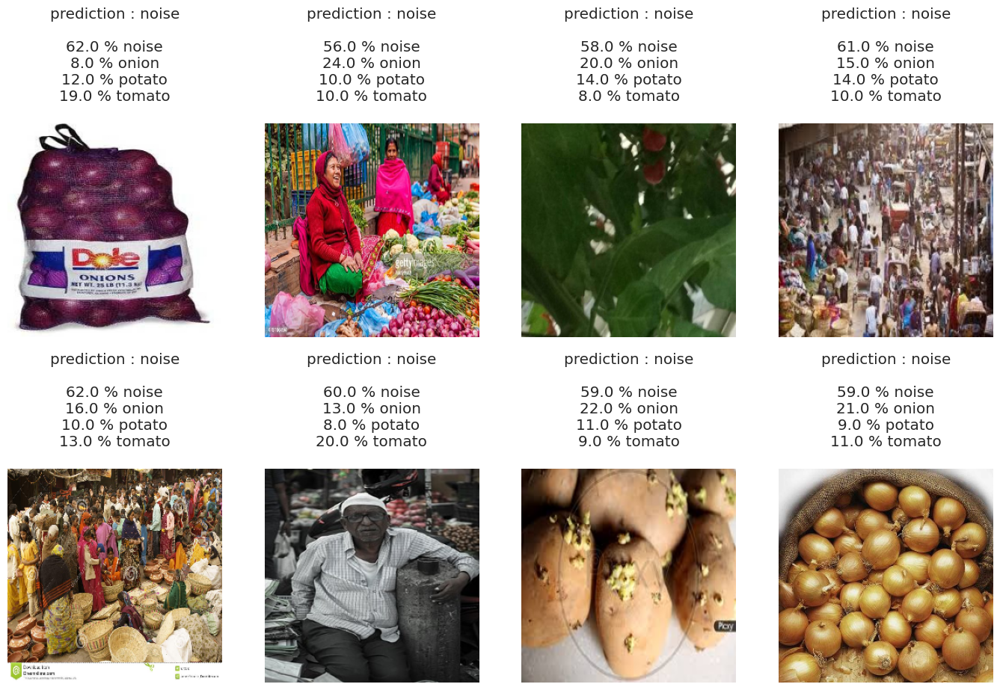

In [ ]:
grid_test_model(model_res)

In [ ]:
result = model_res.evaluate(test_ds)
dict(zip(model_res.metrics_names, result))

11/11 [==============================] - 5s 351ms/step - loss: 1.8386 - accuracy: 0.2308 - precision: 0.2305 - recall: 0.2279


{'loss': 1.8385810852050781,
 'accuracy': 0.23076923191547394,
 'precision': 0.23054754734039307,
 'recall': 0.22792023420333862}

1/1 [==============================] - 0s 22ms/step


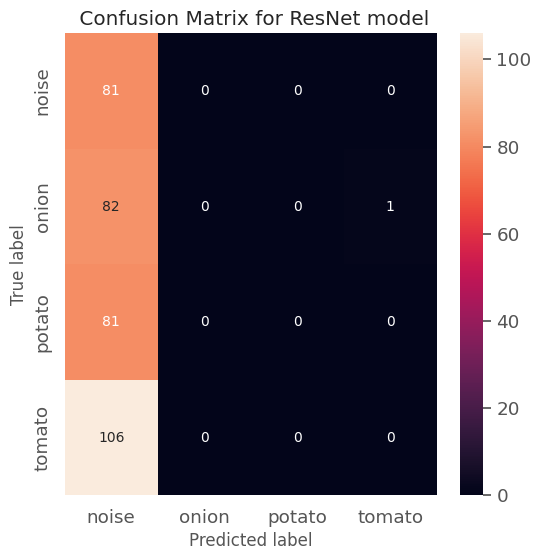

In [ ]:
l1 = []
l2 = []
l3 = []
l4 = []

conf_mat(noise_path, l1, model_res)
conf_mat(onion_path, l2, model_res)
conf_mat(potato_path, l3, model_res)
conf_mat(tomato_path, l4, model_res)

ax = sns.heatmap([l1, l2, l3, l4], xticklabels=class_names, yticklabels=class_names, annot=True, fmt='g')
ax.set(xlabel='Predicted label', ylabel='True label',title = ' Confusion Matrix for ResNet model')
plt.show()

**Observations :**
* With ResNet model we get a test accuracy of 93% and train accuracy of 99.63%.
* Also, the predictions are nearly 100% to actual labels in the dataset.

### 5) **MobileNet Model**

In [ ]:
# MobileNet
base_model_mob = tf.keras.applications.mobilenet.MobileNet(input_shape=(256, 256, 3), include_top = False)
model_mob = base_model_mob.output

model_mob = tf.keras.Sequential([
            tf.keras.layers.Rescaling(1./255),
            tf.keras.layers.InputLayer(input_shape=[image_size[0], image_size[1], 3]),
            base_model_mob,
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dropout(rate = 0.1),
            tf.keras.layers.Dense(4, activation = 'softmax')
        ])

17225924/17225924 [==============================] - 1s 0us/step


In [ ]:
log_dir_mob = "logs/model_mob"

tensorboard_cb = tf.keras.callbacks.TensorBoard(log_dir=log_dir_mob, histogram_freq=1)

checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("MobileNet.h5", save_best_only=True)

early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor = 'val_loss', patience = 5, restore_best_weights=True
)

In [ ]:
model_mob.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4),
              loss = tf.keras.losses.CategoricalCrossentropy(),
              metrics = ['accuracy', 'Precision', 'Recall'])

In [ ]:
history_mob = model_mob.fit(aug_ds, validation_data = valid_ds, epochs = 20,
                            callbacks=[tensorboard_cb, checkpoint_cb, early_stopping_cb])

Epoch 1/20
79/79 [==============================] - 32s 221ms/step - loss: 0.2499 - accuracy: 0.9119 - precision: 0.9301 - recall: 0.8915 - val_loss: 0.1282 - val_accuracy: 0.9506 - val_precision: 0.9504 - val_recall: 0.9474
Epoch 2/20
79/79 [==============================] - 16s 190ms/step - loss: 0.0301 - accuracy: 0.9940 - precision: 0.9944 - recall: 0.9928 - val_loss: 0.1060 - val_accuracy: 0.9633 - val_precision: 0.9633 - val_recall: 0.9633
Epoch 3/20
79/79 [==============================] - 17s 201ms/step - loss: 0.0178 - accuracy: 0.9956 - precision: 0.9960 - recall: 0.9952 - val_loss: 0.0907 - val_accuracy: 0.9729 - val_precision: 0.9729 - val_recall: 0.9729
Epoch 4/20
79/79 [==============================] - 16s 191ms/step - loss: 0.0090 - accuracy: 0.9992 - precision: 0.9992 - recall: 0.9992 - val_loss: 0.0773 - val_accuracy: 0.9777 - val_precision: 0.9777 - val_recall: 0.9777
Epoch 5/20
79/79 [==============================] - 15s 185ms/step - loss: 0.0081 - accuracy: 0.9984

In [ ]:
model_mob.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_4 (Rescaling)     (None, 256, 256, 3)       0         
                                                                 
 input_8 (InputLayer)        multiple                  0         
                                                                 
 mobilenet_1.00_224 (Functi  (None, 8, 8, 1024)        3228864   
 onal)                                                           
                                                                 
 global_average_pooling2d_4  (None, 1024)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dropout_3 (Dropout)         (None, 1024)              0         
                                                                 
 dense_4 (Dense)             (None, 4)                

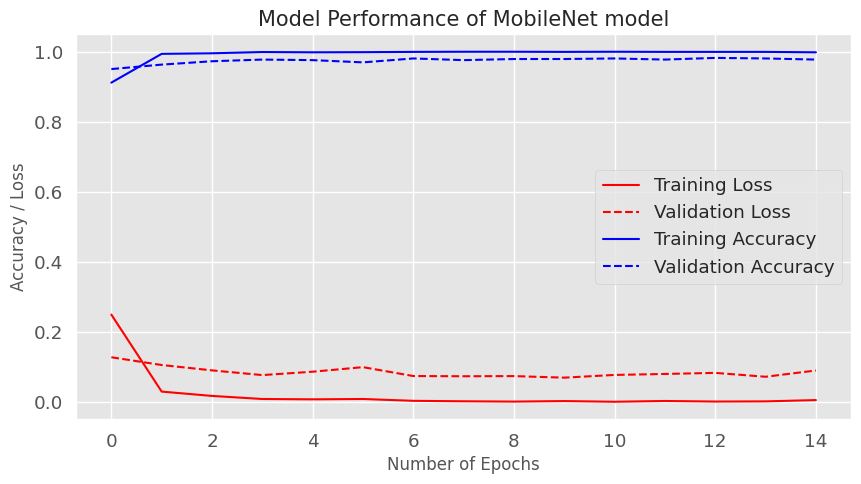

In [ ]:
# Plot the loss graph and accuracy graph
h = history_mob.history
plt.style.use('ggplot')
plt.figure(figsize=(10, 5))
plt.plot(h['loss'], c='red', label='Training Loss')
plt.plot(h['val_loss'], c='red', linestyle='--', label='Validation Loss')
plt.plot(h['accuracy'], c='blue', label='Training Accuracy')
plt.plot(h['val_accuracy'], c='blue', linestyle='--', label='Validation Accuracy')
plt.xlabel("Number of Epochs")
plt.title('Model Performance of MobileNet model', fontsize=15)
plt.ylabel("Accuracy / Loss")
plt.legend(loc='best')
plt.show()

In [ ]:
classwise_accuracy(noise_path, 'noise', model_mob)
classwise_accuracy(onion_path, 'onion', model_mob)
classwise_accuracy(potato_path, 'potato', model_mob)
classwise_accuracy(tomato_path, 'tomato', model_mob)

1/1 [==============================] - 0s 19ms/step

 --> Accuracy for class noise is 81.48% consisting of 81 images 

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1/1 [==============================] - 0s 18ms/step

 --> Accuracy for class onion is 98.8% consisting of 83 images 

------------------------------------------------------------------------------------------------------------------------------------------------------------------

1/1 [==============================] - 0s 19ms/step


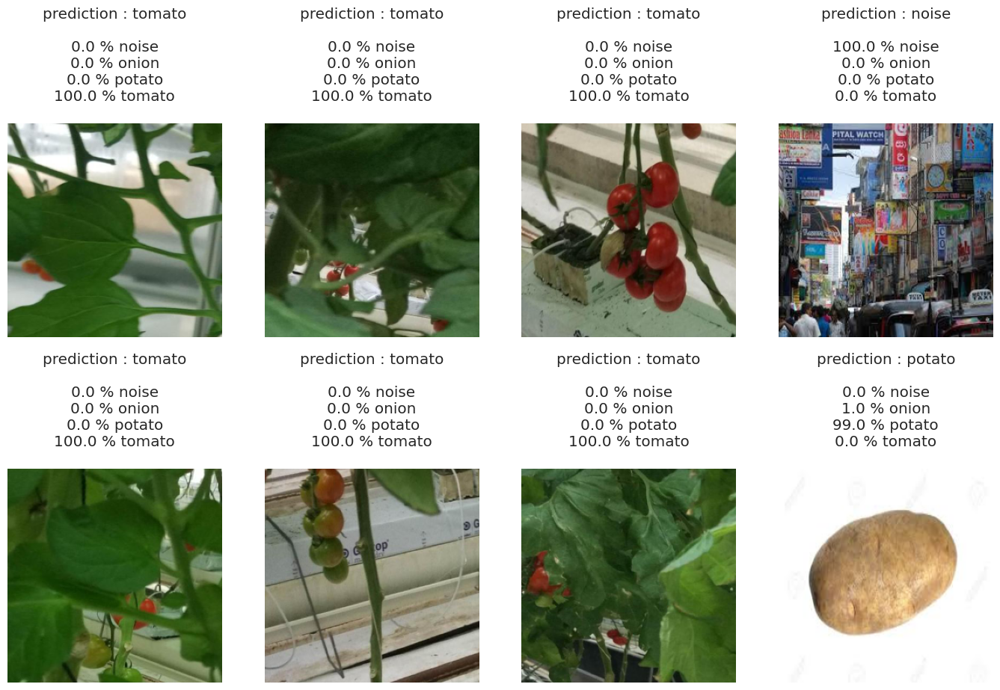

In [ ]:
grid_test_model(model_mob)

In [ ]:
result = model_mob.evaluate(test_ds)
dict(zip(model_mob.metrics_names, result))

11/11 [==============================] - 3s 154ms/step - loss: 0.4206 - accuracy: 0.9117 - precision: 0.9112 - recall: 0.9060


{'loss': 0.4205856919288635,
 'accuracy': 0.9116809368133545,
 'precision': 0.9111747741699219,
 'recall': 0.9059829115867615}

1/1 [==============================] - 0s 18ms/step


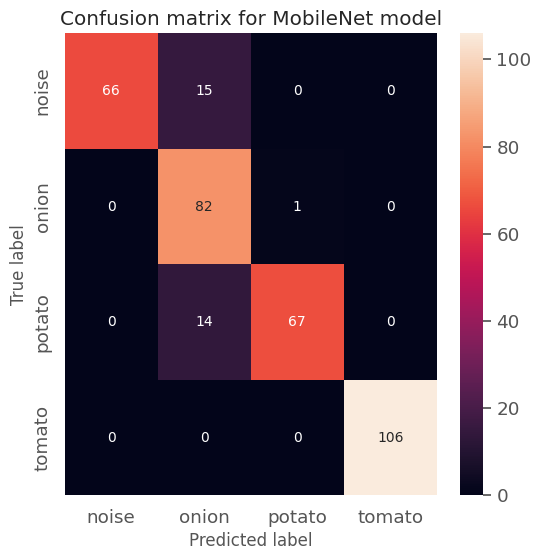

In [ ]:
l1 = []
l2 = []
l3 = []
l4 = []

conf_mat(noise_path, l1, model_mob)
conf_mat(onion_path, l2, model_mob)
conf_mat(potato_path, l3, model_mob)
conf_mat(tomato_path, l4, model_mob)

ax = sns.heatmap([l1, l2, l3, l4], xticklabels=class_names, yticklabels=class_names, annot=True, fmt='g')
ax.set(xlabel='Predicted label', ylabel='True label',title = 'Confusion matrix for MobileNet model')
plt.show()

**Observations :**
* With MobileNet model we get a test accuracy of 91% and train accuracy of 99.89%.
* Also, the predictions are nearly 100% to actual labels in the dataset.

## **Comparison of Trained Model Results**

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Launching TensorBoard...

<IPython.core.display.Javascript object>

## **Conclusions** :

#### >  **Evaluation Results of Trained Models**

| Model Name | Test Accuracy| Train Accuracy| Precision |Recall
| --- | --- | ---| --- | --- |
| Base CNN | 74.93% | 79.78% |0.8000 | 0.7066
| Revised CNN |  88.88%| 89.83% |0.9121 | 0.8575
| VGG19 | 90% | 99.84% |0.8997 |0.8946
| ResNet | 93% | 99.63% |0.9366 |0.9259
| MobileNet | 91.45% | 100% |0.9145 |0.9145

<br>

* After training all of our models, we found **ResNet** model to be the most accurate model on our dataset.
* Also, Resnet model gave us the highest test accuracy among all models and the base CNN model has the lowest test accuracy.
* ResNet Model is nearly 100% sure of the correct class in every image we plotted above, indicating a very good choice for our classfication task.

---------------------------------------------------------

**Submitted by  : Mrudula A P**